In [1]:
%load_ext autoreload
%autoreload 2
import cv2
from models.frame import Frame
from typing import List

participant_number = '7'
video_path = f"./datasets/MIT/Videos/P{participant_number}.avi"
cap = cv2.VideoCapture(video_path)

frames: List[Frame] = []
cap = cv2.VideoCapture(video_path)
frame_count = 1000
while True:
    ret, frame = cap.read()
    if not ret:
        break
    frames.append(Frame(len(frames), participant_number, frame))
cap.release()

frames = frames[:frame_count]

In [8]:
from models.frame import Frame
from utils.face_analyzer import FaceAnalyzer


def analyze(frames: list[Frame]):
    face_analyzer = FaceAnalyzer()
    results = []
    for frame in frames:
        frame.face = face_analyzer.get_face(frame.image)
        frame.smile = face_analyzer.get_smile(frame.image, frame.face) if frame.face is not None else None
        if frame.smile is not None:
            results.append(1)
        else:
            results.append(0)
    return results

predictions = analyze(frames)
with open(f'datasets/MIT/SmileData/pre/Smoothed-features-P{participant_number}.txt') as file:
    smile_intensities = [float(line.split()[0]) for line in file]
threshold = 50
ground_truth = [1 if intensity > threshold else 0 for intensity in smile_intensities]

In [9]:
ground_truth = ground_truth[:frame_count]
print(predictions)
print(ground_truth)

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

In [4]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

accuracy = accuracy_score(ground_truth, predictions)
precision = precision_score(ground_truth, predictions)
recall = recall_score(ground_truth, predictions)
f1 = f1_score(ground_truth, predictions)

print(f"Accuracy: {accuracy * 100:.0f}%")
print(f"Precision: {precision * 100:.0f}%")
print(f"Recall: {recall * 100:.0f}%")
print(f"F1 Score: {f1 * 100:.0f}%")

Accuracy: 1%
Precision: 1%
Recall: 100%
F1 Score: 1%


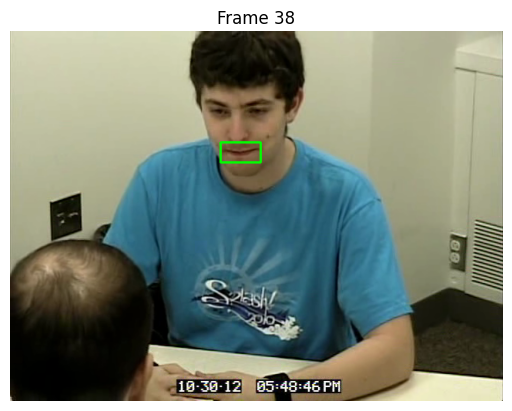

prediction 1
(np.int32(273), np.int32(144), np.int32(52), np.int32(26))


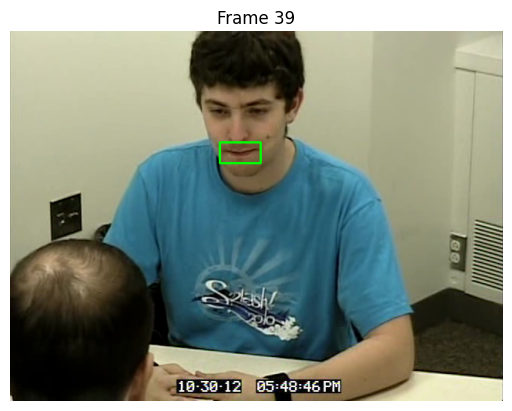

prediction 1
(np.int32(272), np.int32(144), np.int32(53), np.int32(27))


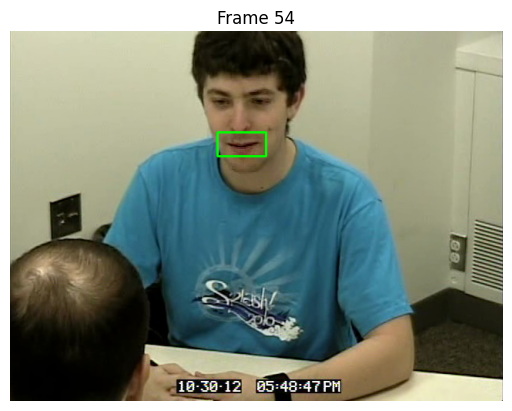

prediction 1
(np.int32(269), np.int32(131), np.int32(63), np.int32(31))


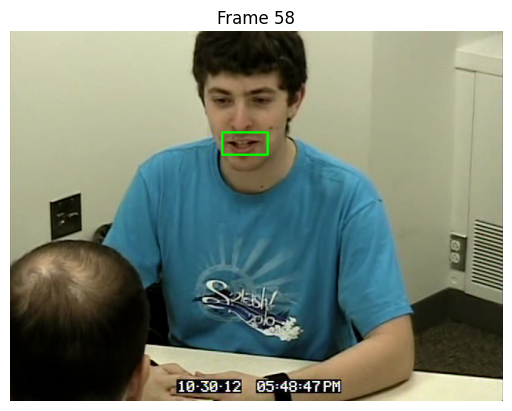

prediction 1
(np.int32(275), np.int32(131), np.int32(59), np.int32(29))


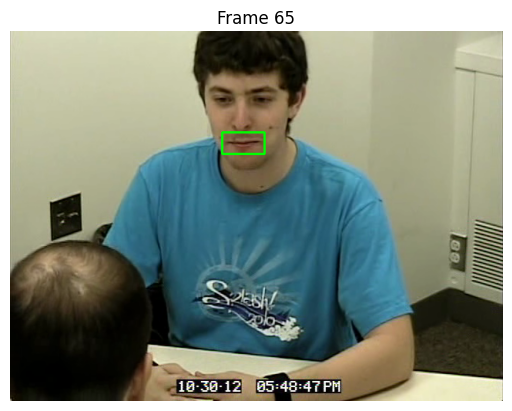

prediction 1
(np.int32(275), np.int32(131), np.int32(55), np.int32(28))


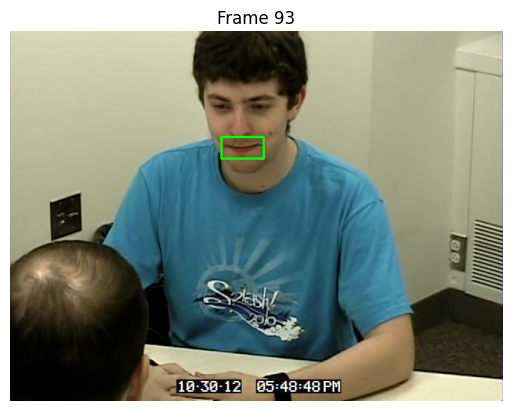

prediction 1
(np.int32(274), np.int32(137), np.int32(55), np.int32(28))


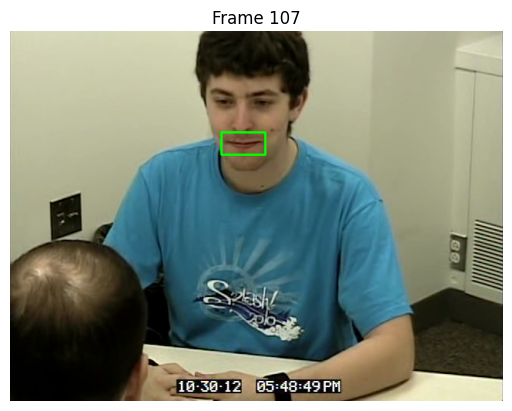

prediction 1
(np.int32(274), np.int32(131), np.int32(57), np.int32(29))


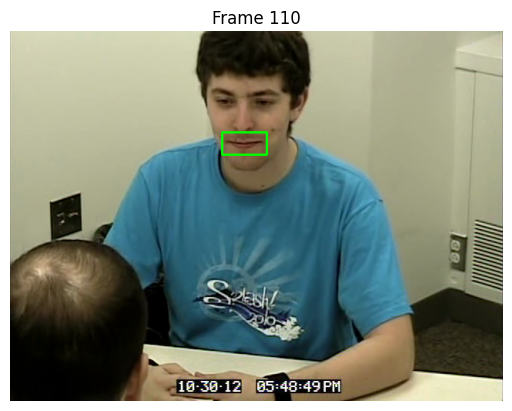

prediction 1
(np.int32(275), np.int32(131), np.int32(58), np.int32(29))


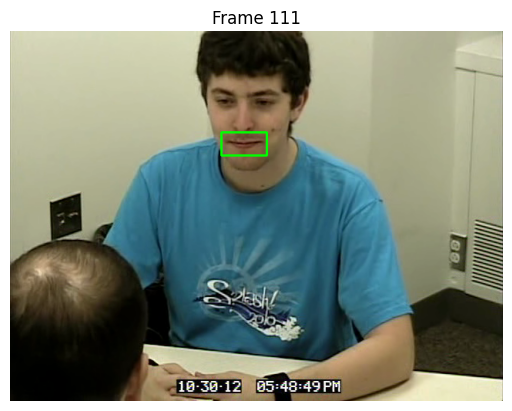

prediction 1
(np.int32(274), np.int32(131), np.int32(59), np.int32(30))


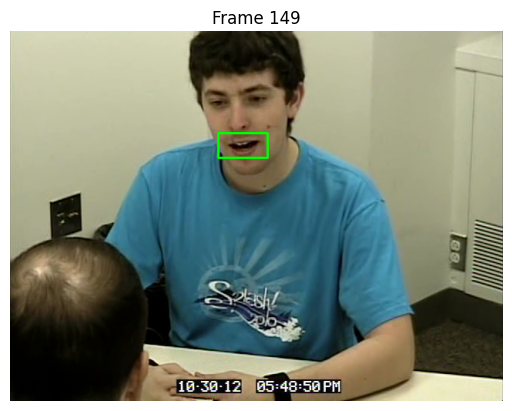

prediction 1
(np.int32(270), np.int32(132), np.int32(64), np.int32(32))


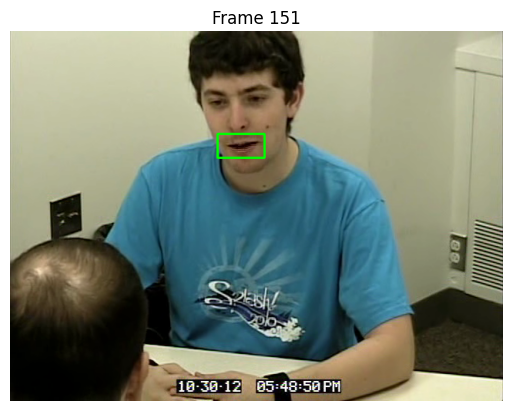

prediction 1
(np.int32(269), np.int32(133), np.int32(61), np.int32(31))


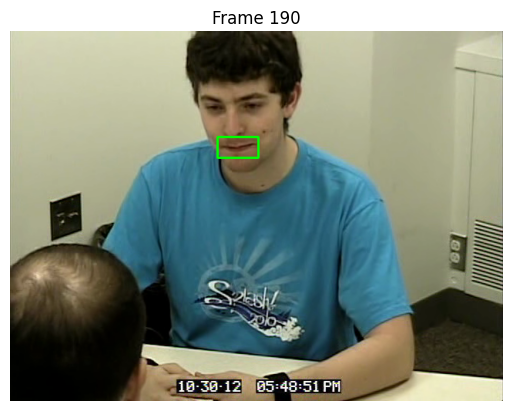

prediction 1
(np.int32(269), np.int32(137), np.int32(53), np.int32(27))


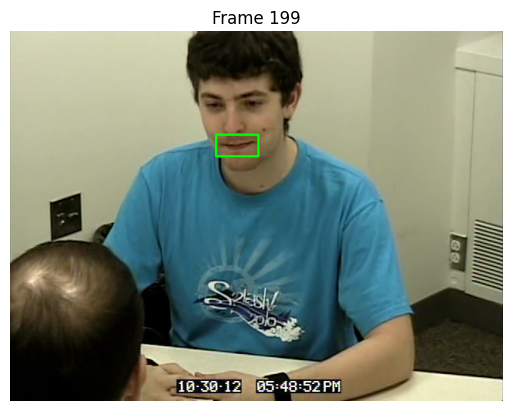

prediction 1
(np.int32(267), np.int32(134), np.int32(55), np.int32(28))


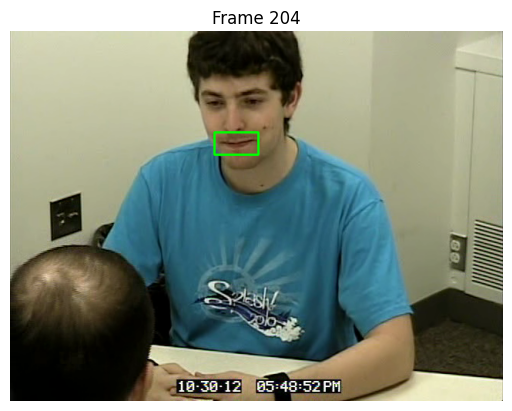

prediction 1
(np.int32(265), np.int32(131), np.int32(57), np.int32(29))


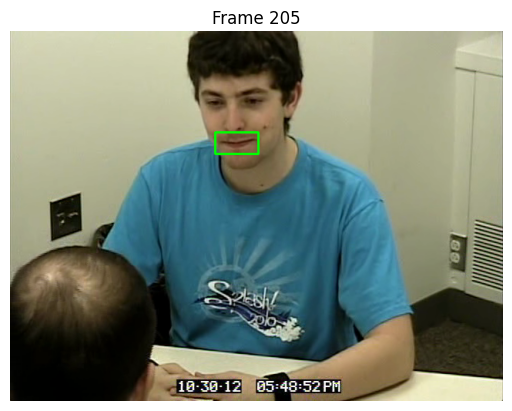

prediction 1
(np.int32(266), np.int32(131), np.int32(56), np.int32(28))


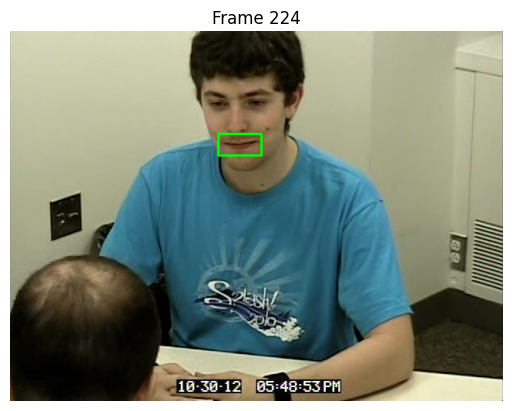

prediction 1
(np.int32(270), np.int32(133), np.int32(56), np.int32(28))


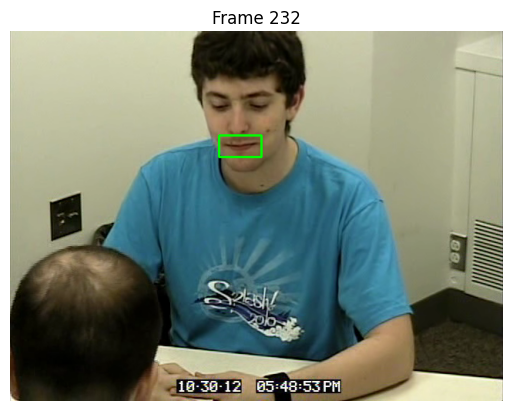

prediction 1
(np.int32(271), np.int32(135), np.int32(55), np.int32(28))


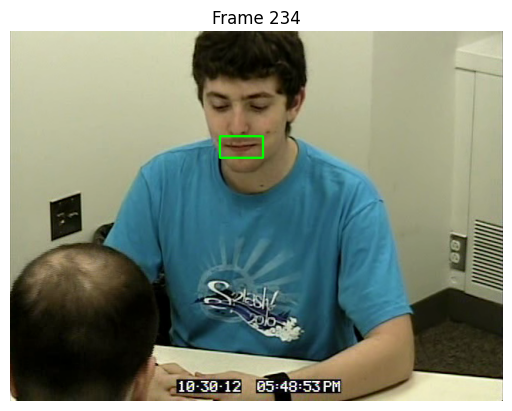

prediction 1
(np.int32(272), np.int32(136), np.int32(56), np.int32(28))


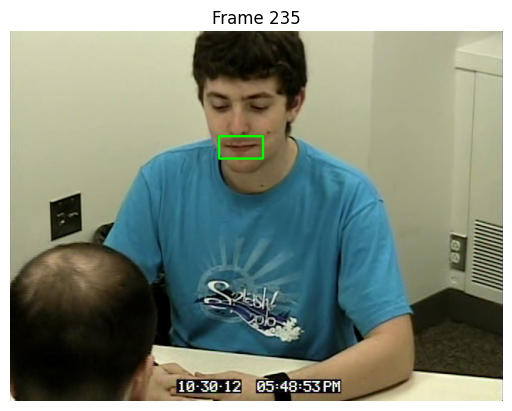

prediction 1
(np.int32(271), np.int32(136), np.int32(57), np.int32(29))


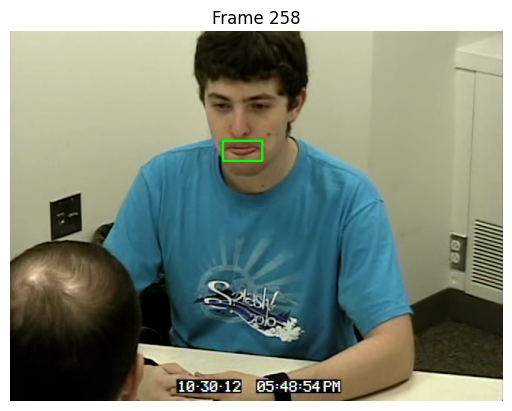

prediction 1
(np.int32(276), np.int32(142), np.int32(51), np.int32(26))


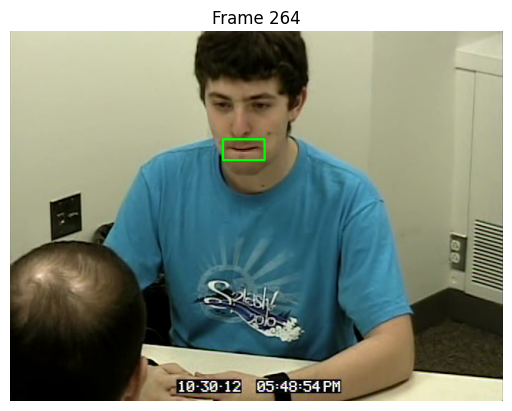

prediction 1
(np.int32(276), np.int32(140), np.int32(54), np.int32(27))


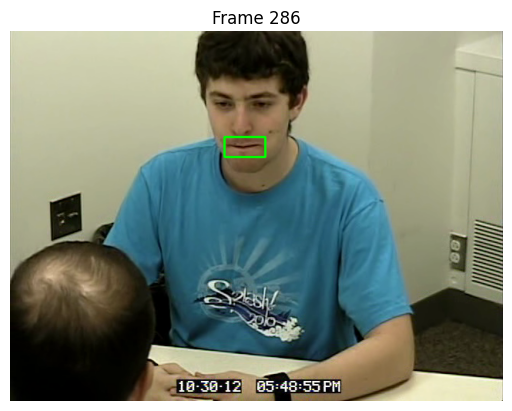

prediction 1
(np.int32(278), np.int32(137), np.int32(53), np.int32(26))


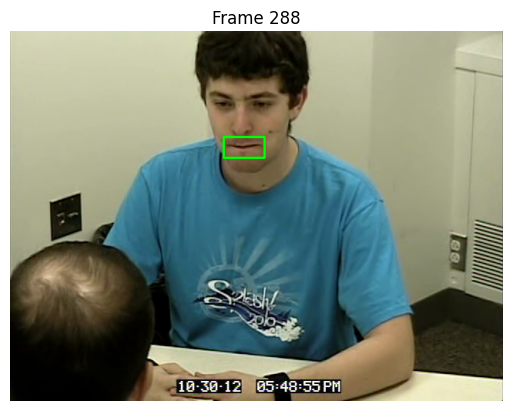

prediction 1
(np.int32(277), np.int32(137), np.int32(53), np.int32(27))


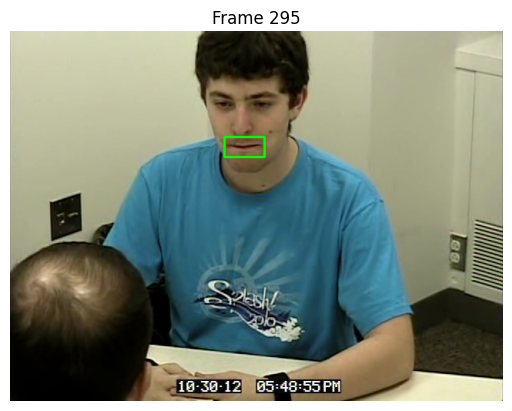

prediction 1
(np.int32(278), np.int32(137), np.int32(52), np.int32(26))


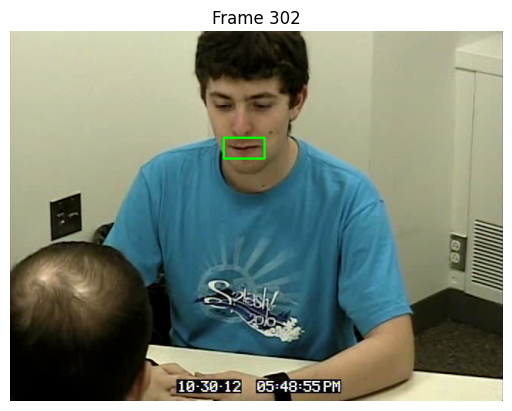

prediction 1
(np.int32(277), np.int32(138), np.int32(53), np.int32(27))


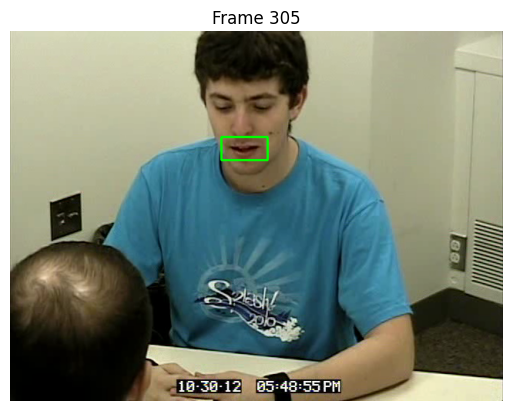

prediction 1
(np.int32(274), np.int32(137), np.int32(60), np.int32(30))


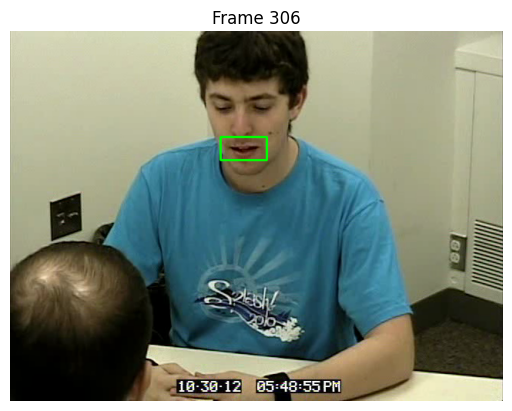

prediction 1
(np.int32(273), np.int32(137), np.int32(60), np.int32(30))


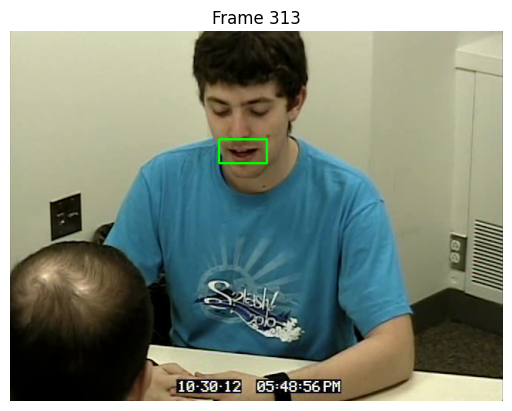

prediction 1
(np.int32(271), np.int32(140), np.int32(62), np.int32(31))


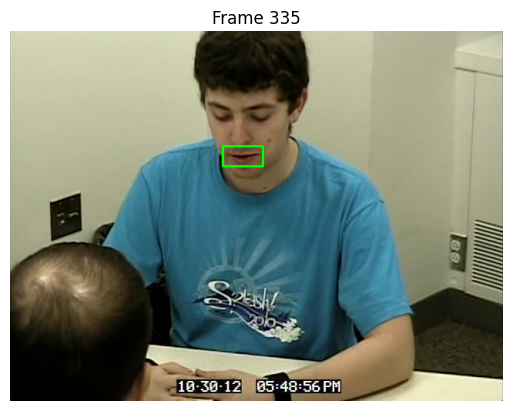

prediction 1
(np.int32(276), np.int32(149), np.int32(52), np.int32(26))


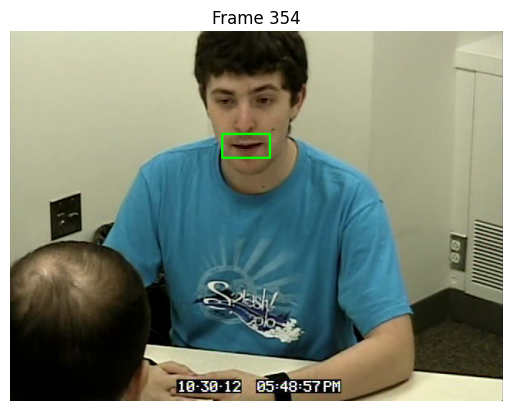

prediction 1
(np.int32(275), np.int32(133), np.int32(62), np.int32(31))


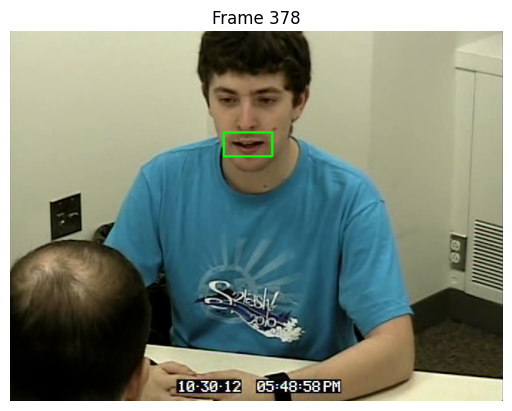

prediction 1
(np.int32(277), np.int32(131), np.int32(63), np.int32(31))


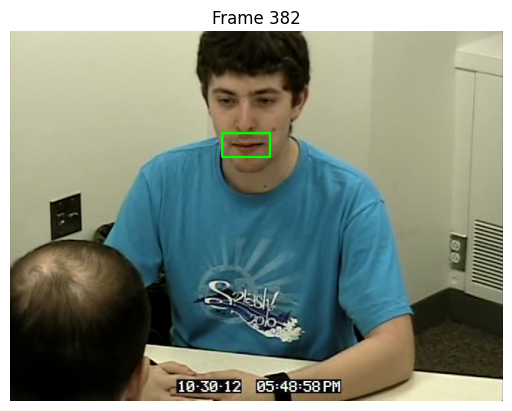

prediction 1
(np.int32(275), np.int32(132), np.int32(62), np.int32(31))


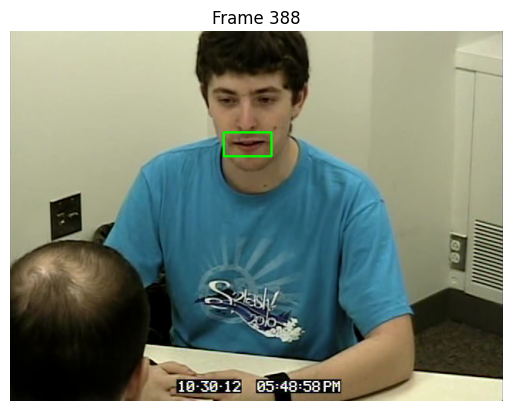

prediction 1
(np.int32(277), np.int32(131), np.int32(62), np.int32(31))


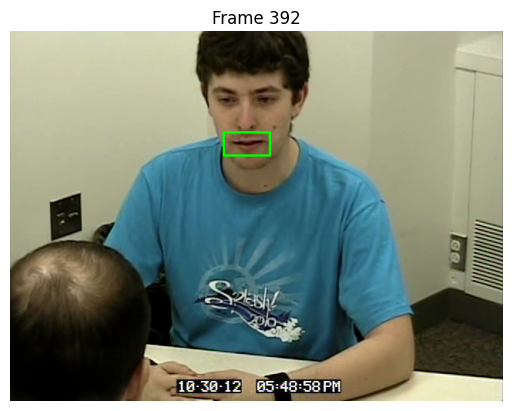

prediction 1
(np.int32(277), np.int32(131), np.int32(60), np.int32(30))


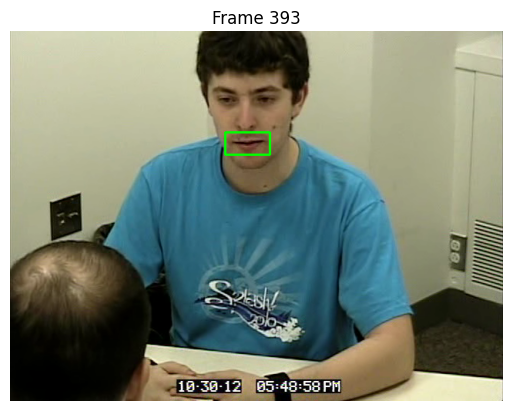

prediction 1
(np.int32(279), np.int32(131), np.int32(58), np.int32(29))


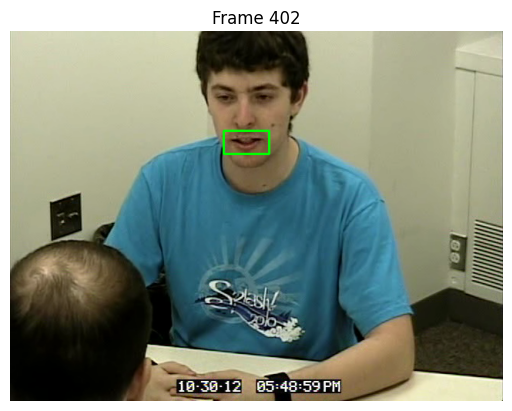

prediction 1
(np.int32(277), np.int32(129), np.int32(59), np.int32(30))


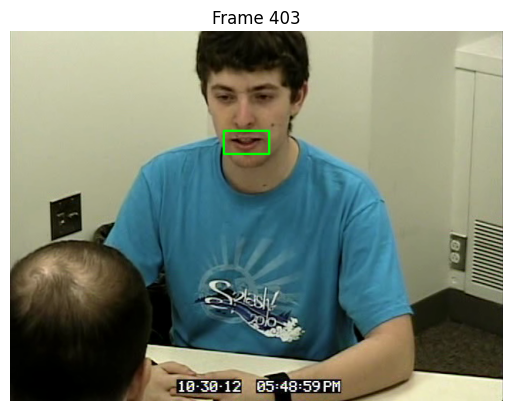

prediction 1
(np.int32(277), np.int32(129), np.int32(59), np.int32(30))


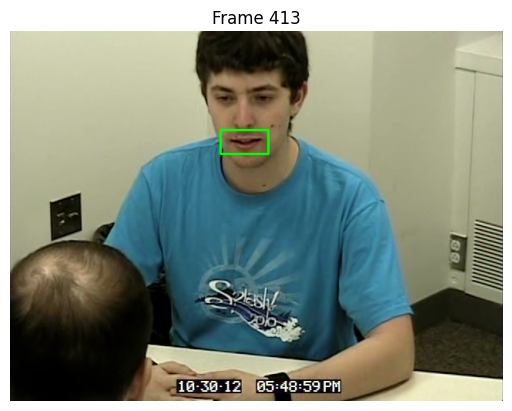

prediction 1
(np.int32(273), np.int32(128), np.int32(62), np.int32(31))


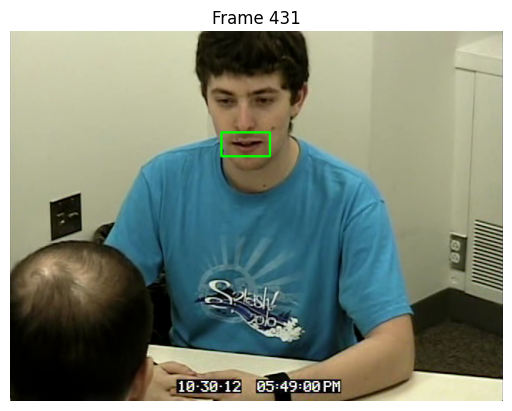

prediction 1
(np.int32(274), np.int32(131), np.int32(63), np.int32(31))


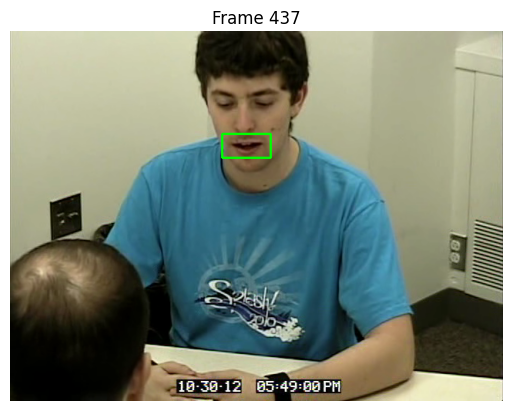

prediction 1
(np.int32(275), np.int32(133), np.int32(63), np.int32(31))


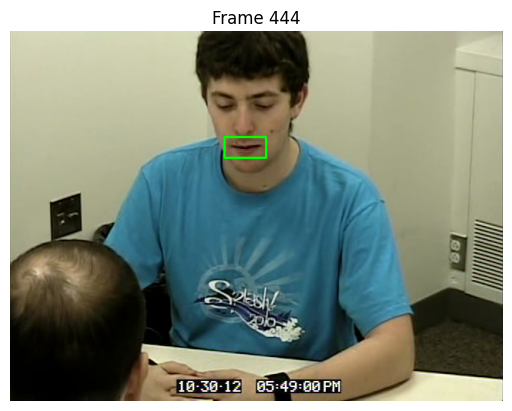

prediction 1
(np.int32(278), np.int32(137), np.int32(54), np.int32(27))


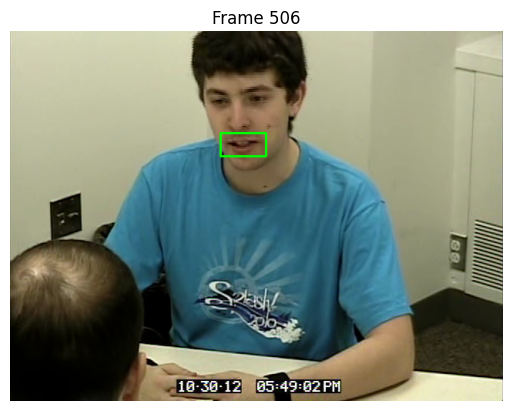

prediction 1
(np.int32(273), np.int32(132), np.int32(59), np.int32(30))


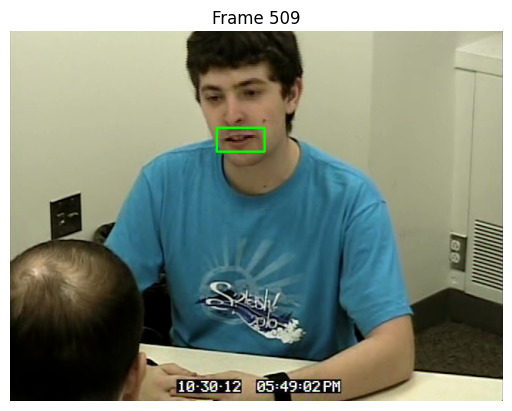

prediction 1
(np.int32(268), np.int32(125), np.int32(62), np.int32(31))


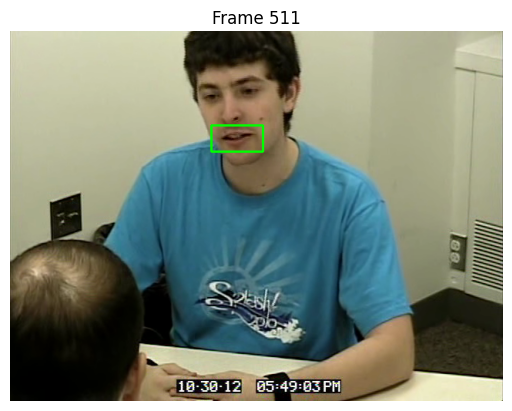

prediction 1
(np.int32(261), np.int32(122), np.int32(67), np.int32(34))


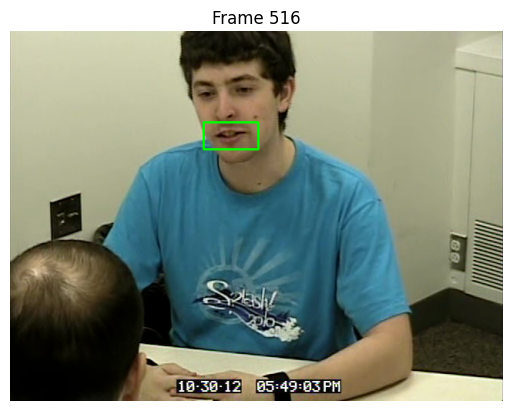

prediction 1
(np.int32(251), np.int32(118), np.int32(71), np.int32(35))


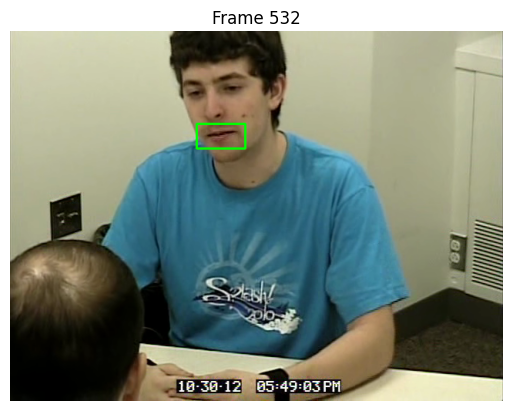

prediction 1
(np.int32(242), np.int32(120), np.int32(63), np.int32(32))


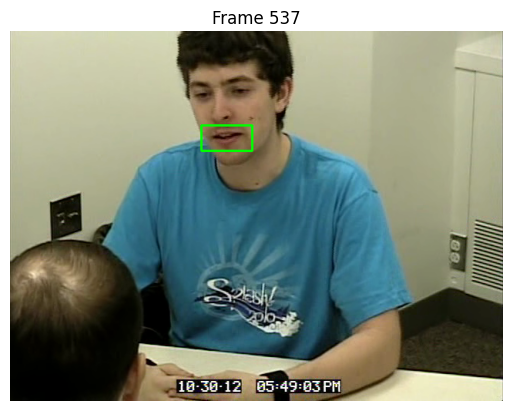

prediction 1
(np.int32(248), np.int32(122), np.int32(66), np.int32(33))


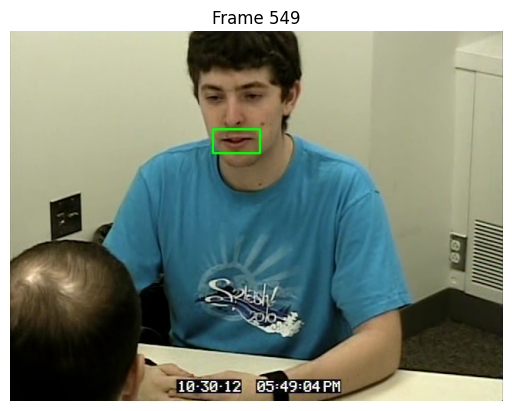

prediction 1
(np.int32(263), np.int32(127), np.int32(61), np.int32(31))


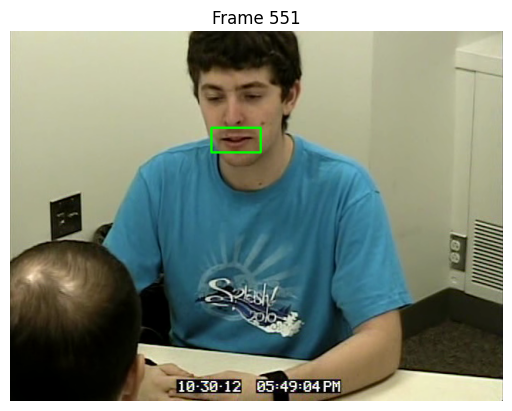

prediction 1
(np.int32(261), np.int32(125), np.int32(64), np.int32(32))


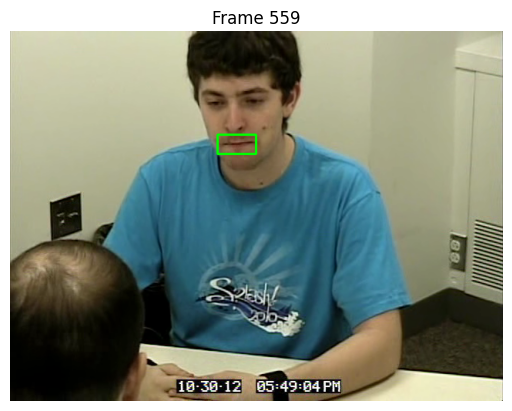

prediction 1
(np.int32(269), np.int32(134), np.int32(50), np.int32(25))


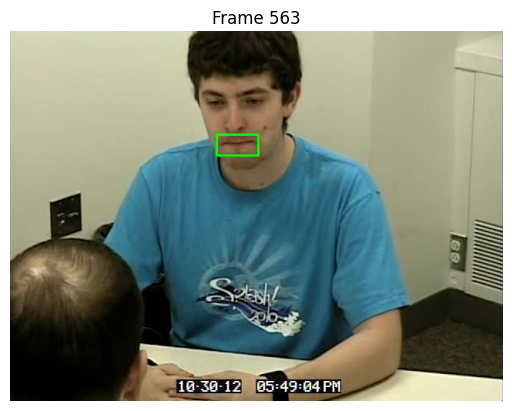

prediction 1
(np.int32(268), np.int32(134), np.int32(54), np.int32(27))


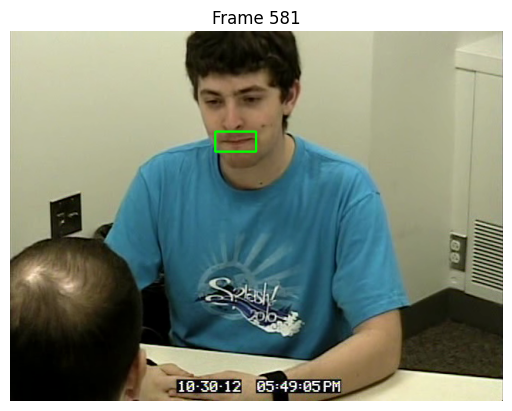

prediction 1
(np.int32(266), np.int32(130), np.int32(53), np.int32(26))


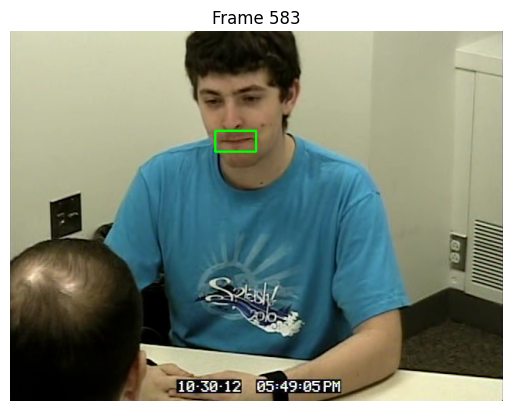

prediction 1
(np.int32(266), np.int32(129), np.int32(53), np.int32(27))


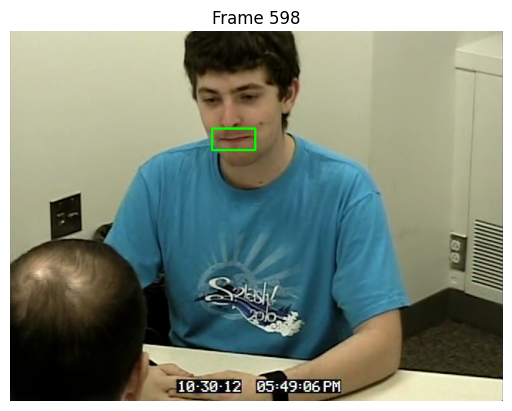

prediction 1
(np.int32(262), np.int32(126), np.int32(56), np.int32(28))


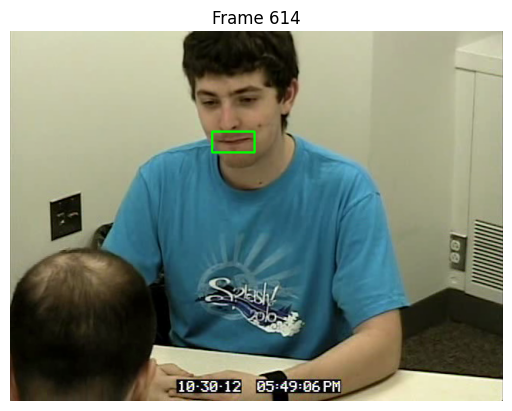

prediction 1
(np.int32(262), np.int32(130), np.int32(55), np.int32(27))


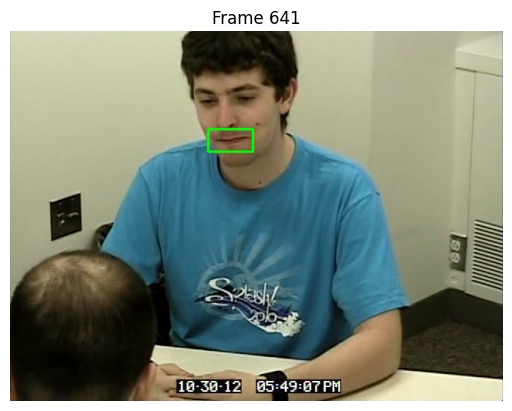

prediction 1
(np.int32(257), np.int32(127), np.int32(58), np.int32(29))


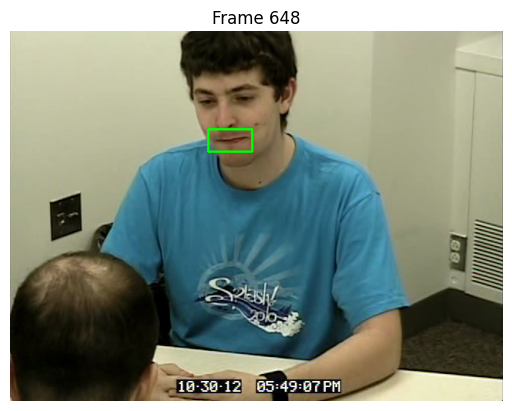

prediction 1
(np.int32(257), np.int32(127), np.int32(57), np.int32(29))


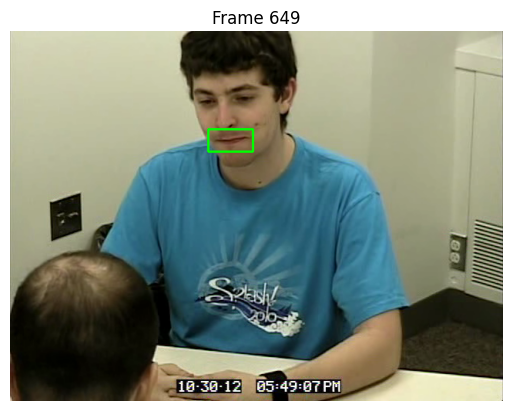

prediction 1
(np.int32(257), np.int32(127), np.int32(58), np.int32(29))


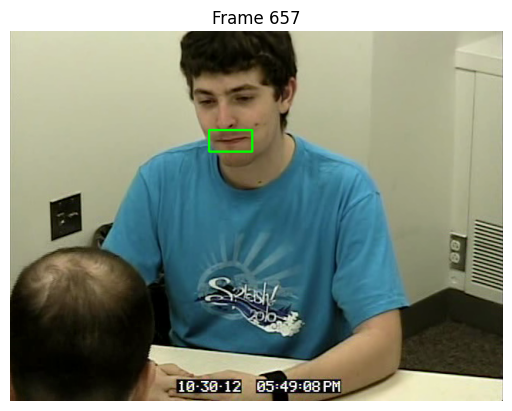

prediction 1
(np.int32(258), np.int32(128), np.int32(56), np.int32(28))


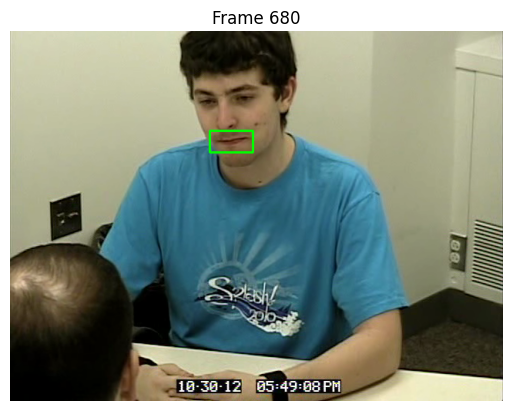

prediction 1
(np.int32(259), np.int32(129), np.int32(56), np.int32(28))


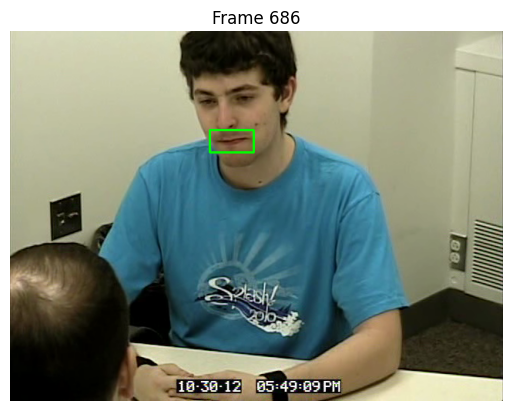

prediction 1
(np.int32(259), np.int32(128), np.int32(57), np.int32(29))


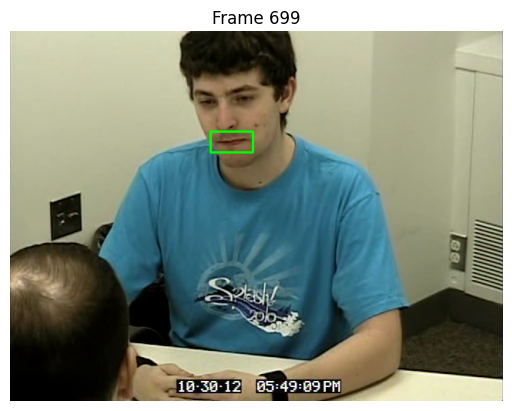

prediction 1
(np.int32(260), np.int32(130), np.int32(55), np.int32(27))


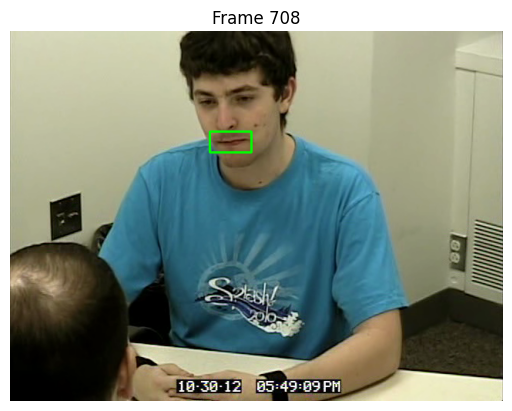

prediction 1
(np.int32(259), np.int32(130), np.int32(54), np.int32(27))


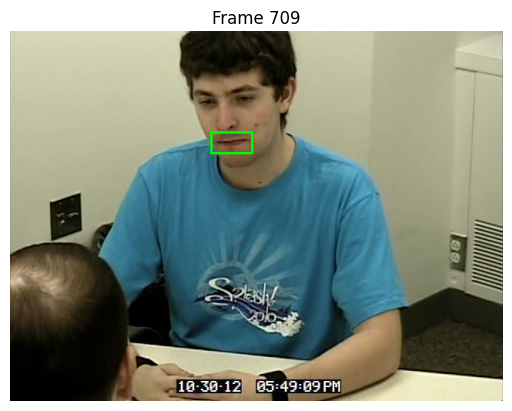

prediction 1
(np.int32(261), np.int32(131), np.int32(53), np.int32(27))


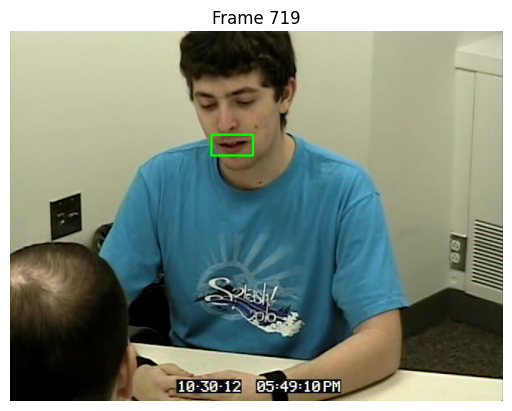

prediction 1
(np.int32(261), np.int32(134), np.int32(54), np.int32(27))


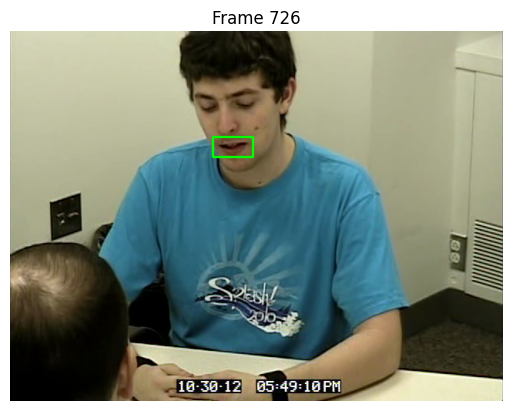

prediction 1
(np.int32(263), np.int32(137), np.int32(52), np.int32(26))


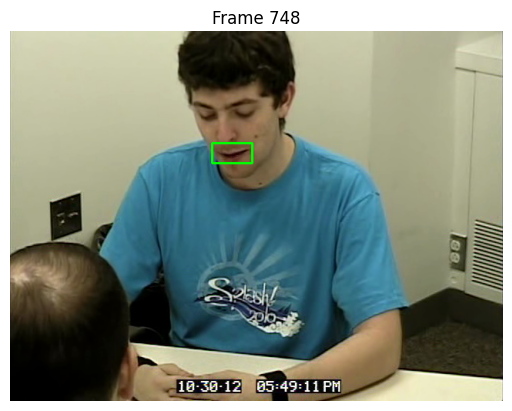

prediction 1
(np.int32(262), np.int32(145), np.int32(52), np.int32(26))


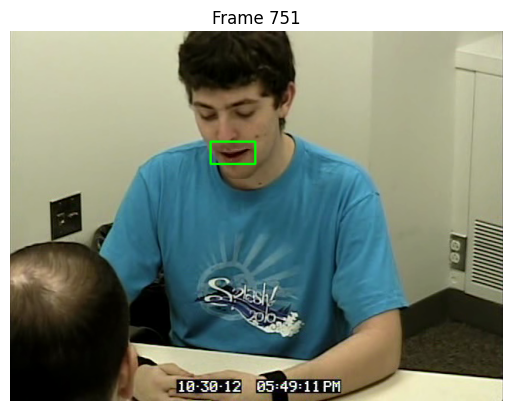

prediction 1
(np.int32(260), np.int32(143), np.int32(58), np.int32(29))


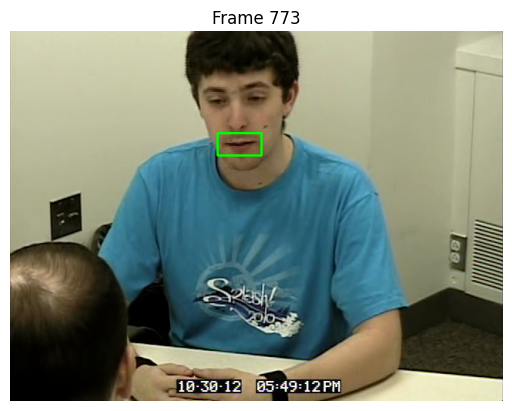

prediction 1
(np.int32(269), np.int32(132), np.int32(57), np.int32(29))


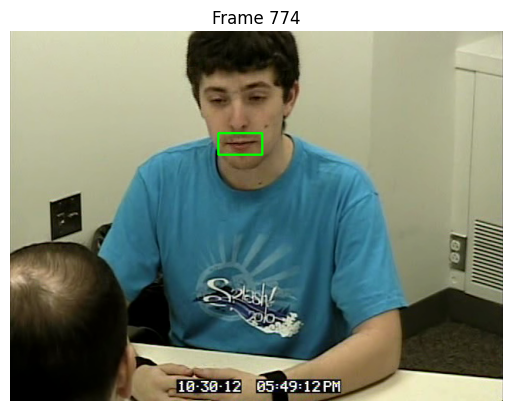

prediction 1
(np.int32(270), np.int32(132), np.int32(57), np.int32(28))


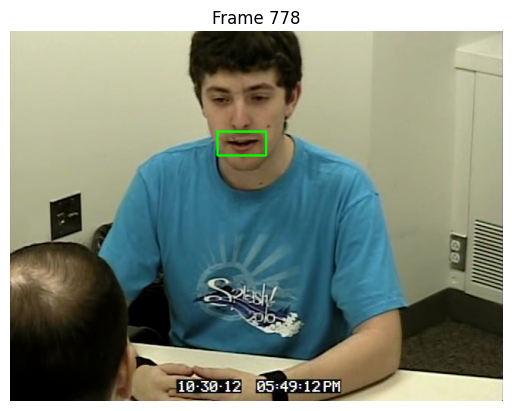

prediction 1
(np.int32(269), np.int32(130), np.int32(63), np.int32(31))


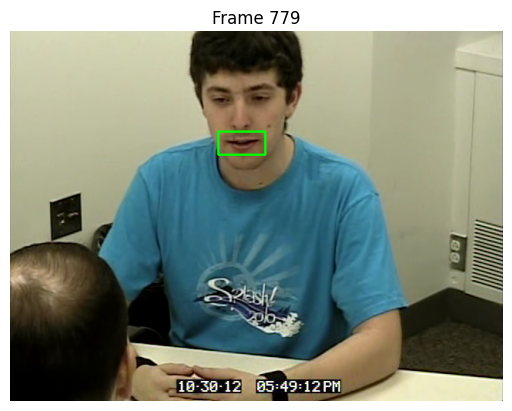

prediction 1
(np.int32(270), np.int32(130), np.int32(61), np.int32(30))


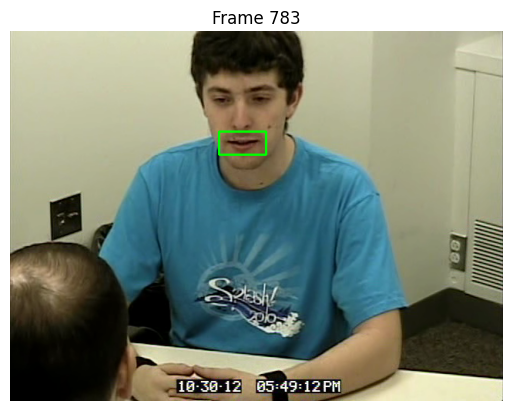

prediction 1
(np.int32(271), np.int32(130), np.int32(61), np.int32(30))


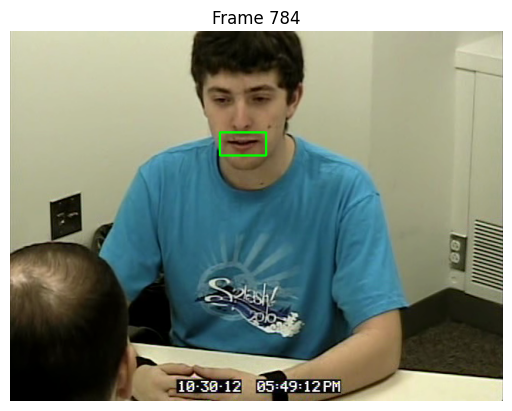

prediction 1
(np.int32(272), np.int32(131), np.int32(60), np.int32(30))


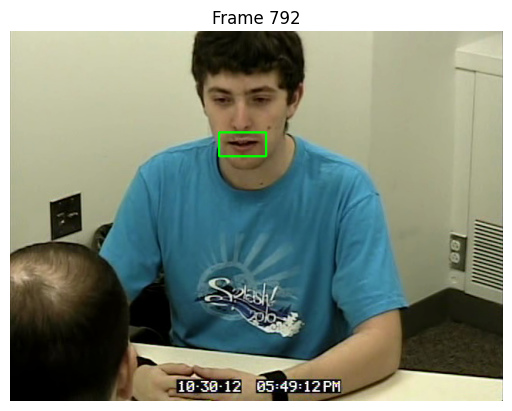

prediction 1
(np.int32(271), np.int32(131), np.int32(61), np.int32(31))


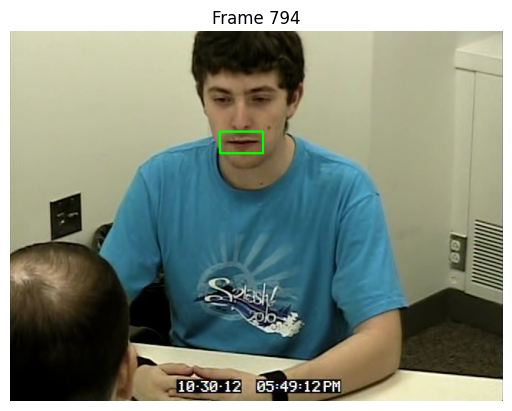

prediction 1
(np.int32(272), np.int32(130), np.int32(56), np.int32(28))


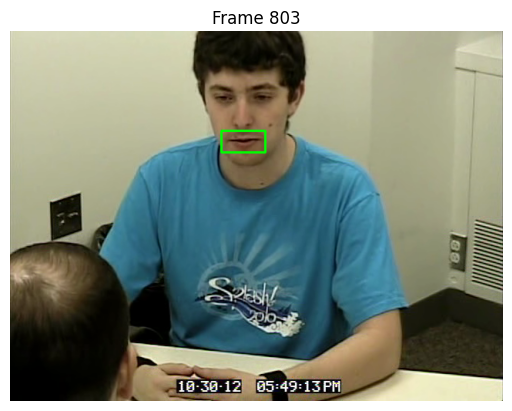

prediction 1
(np.int32(274), np.int32(129), np.int32(57), np.int32(28))


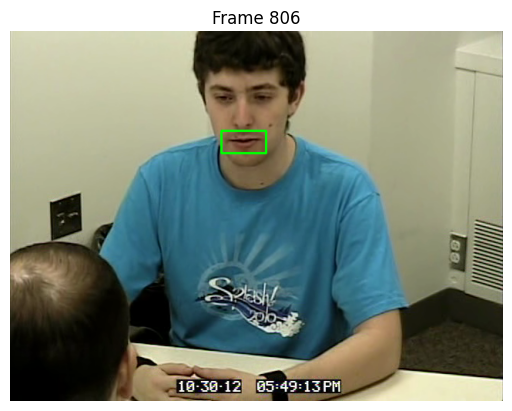

prediction 1
(np.int32(274), np.int32(129), np.int32(58), np.int32(29))


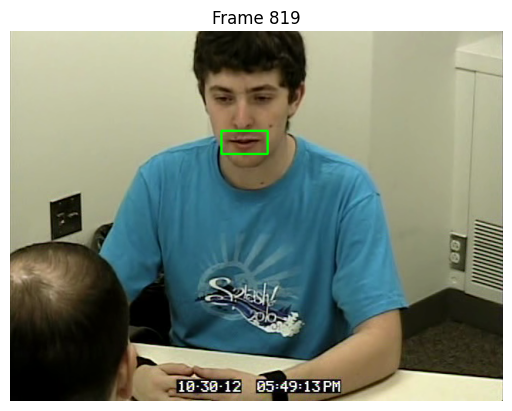

prediction 1
(np.int32(274), np.int32(129), np.int32(60), np.int32(30))


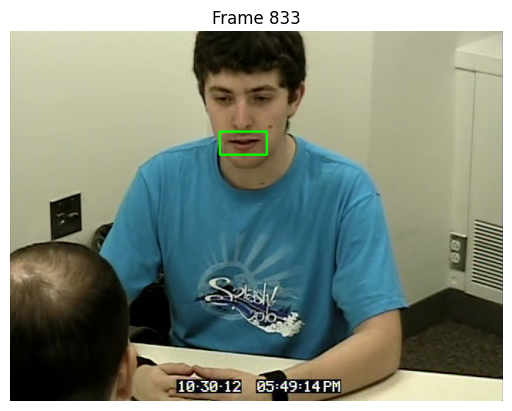

prediction 1
(np.int32(272), np.int32(130), np.int32(61), np.int32(30))


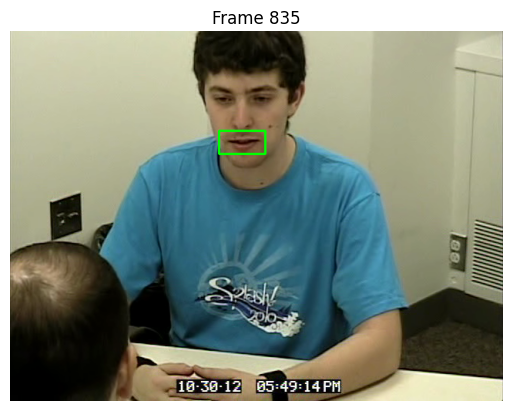

prediction 1
(np.int32(271), np.int32(129), np.int32(60), np.int32(30))


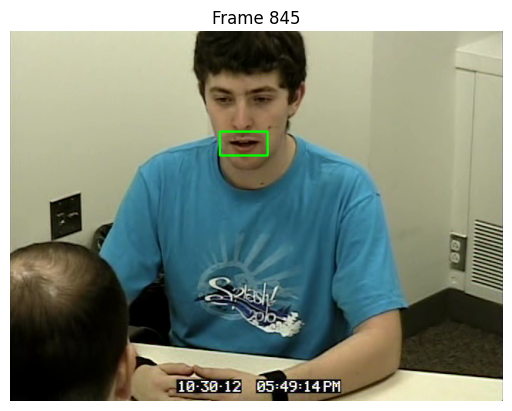

prediction 1
(np.int32(272), np.int32(130), np.int32(62), np.int32(31))


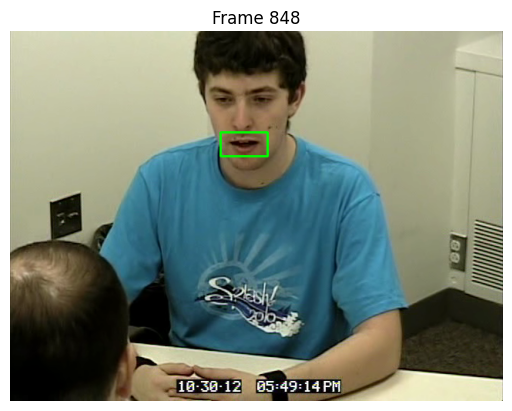

prediction 1
(np.int32(273), np.int32(131), np.int32(61), np.int32(31))


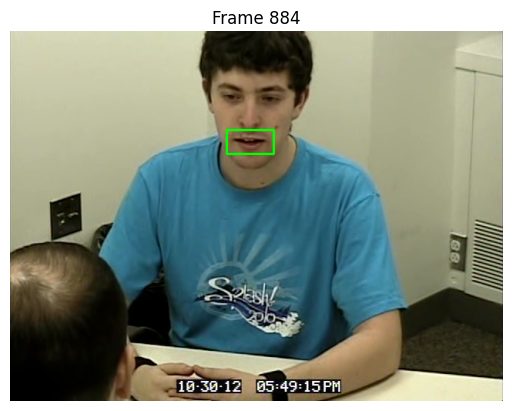

prediction 1
(np.int32(281), np.int32(128), np.int32(61), np.int32(31))


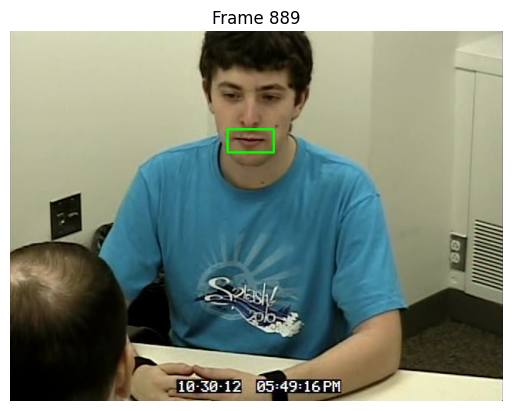

prediction 1
(np.int32(282), np.int32(127), np.int32(60), np.int32(30))


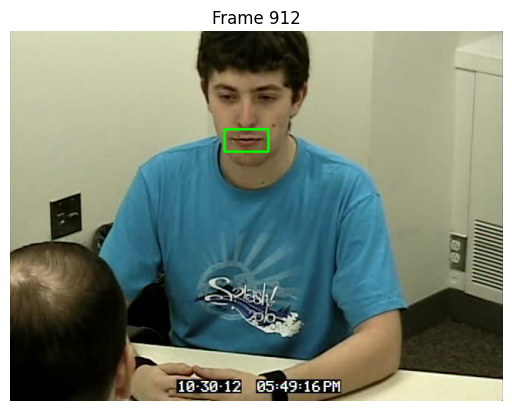

prediction 1
(np.int32(278), np.int32(127), np.int32(57), np.int32(29))


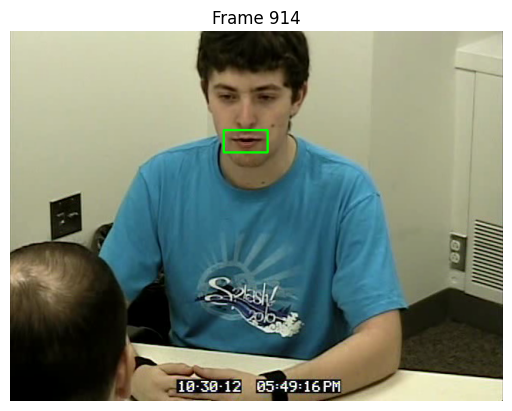

prediction 1
(np.int32(277), np.int32(128), np.int32(57), np.int32(29))


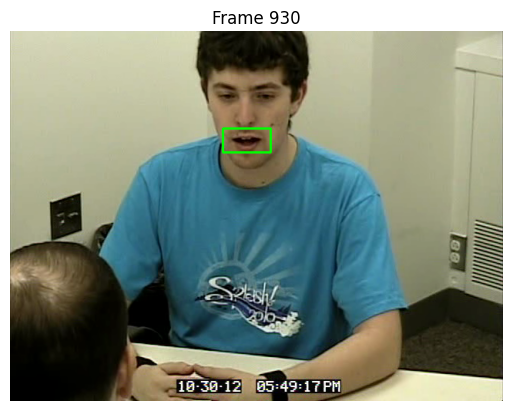

prediction 1
(np.int32(276), np.int32(126), np.int32(62), np.int32(31))


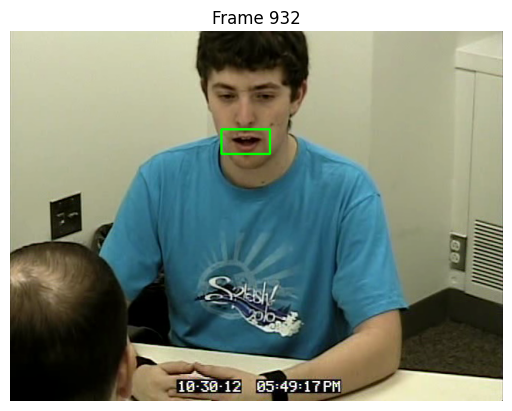

prediction 1
(np.int32(274), np.int32(127), np.int32(63), np.int32(32))


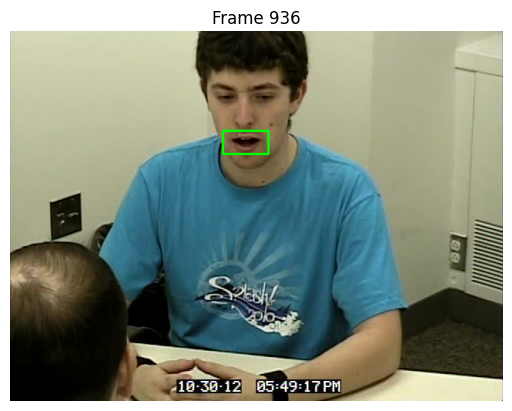

prediction 1
(np.int32(276), np.int32(129), np.int32(59), np.int32(30))


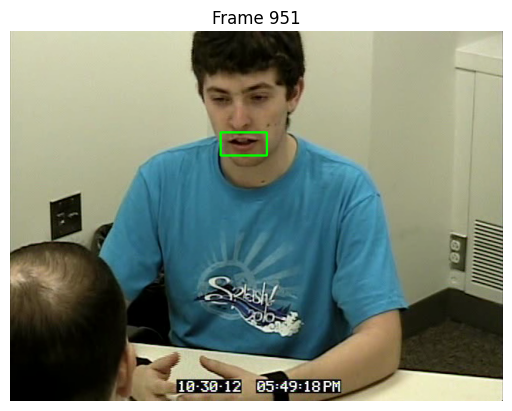

prediction 1
(np.int32(273), np.int32(131), np.int32(60), np.int32(30))


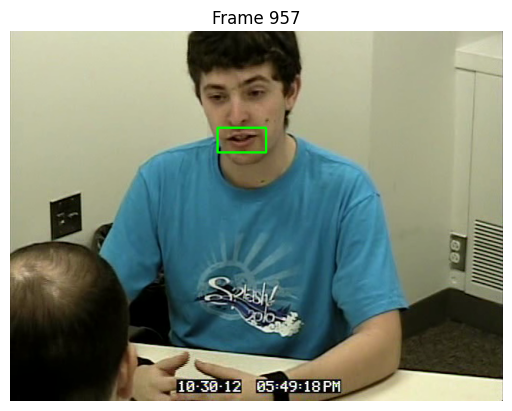

prediction 1
(np.int32(269), np.int32(125), np.int32(63), np.int32(32))


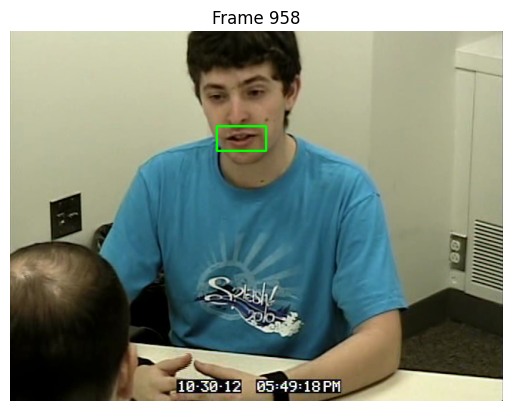

prediction 1
(np.int32(268), np.int32(123), np.int32(64), np.int32(32))


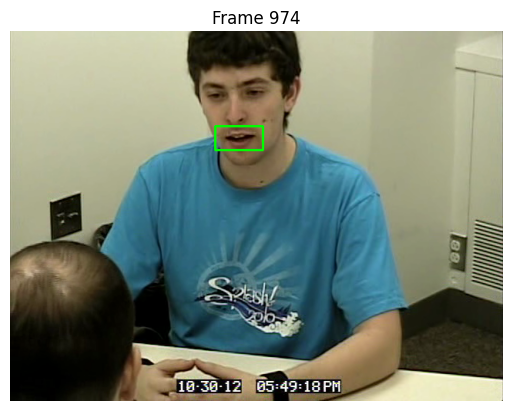

prediction 1
(np.int32(266), np.int32(123), np.int32(62), np.int32(31))


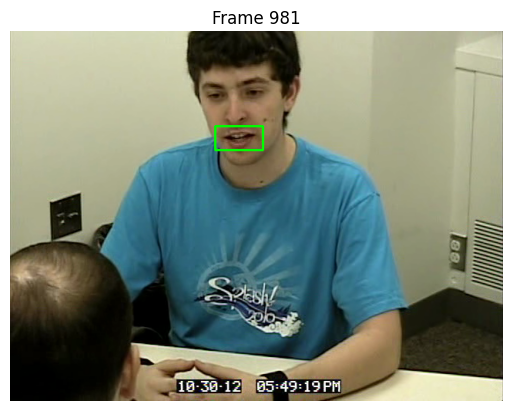

prediction 1
(np.int32(266), np.int32(123), np.int32(62), np.int32(31))


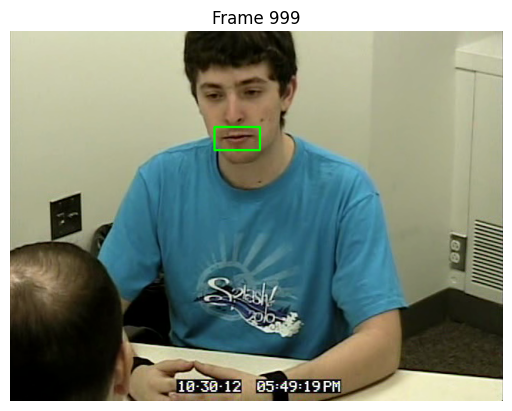

prediction 1
(np.int32(265), np.int32(124), np.int32(59), np.int32(30))


In [6]:
import random

for frame in sorted(random.sample(frames, 100), key=lambda x: x.index):
    if (predictions[frame.index] != ground_truth[frame.index]):
        frame.draw_smile()
        frame.display()
        print("prediction " + str(predictions[frame.index]))
        print(frame.smile)